Elssie Guerra
Final Project
NYC Rolling Sales

                                                    # Final Project
                                                    
Choose different models learned in DSC 478, and select the best one to predict the Sale Price of the property. We will split the data into training and testing to see which model gives us the best result.

In [466]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline

nyc = pd.read_csv("nyc-rolling-sales .csv", sep=',', na_values=[' -  '])
nyc.head(5)

,Unnamed: 0,BOROUGH,NEIGHBORHOOD,BUILDING_CLASS_CATEGORY,TAX_CLASS_AT_PRESENT,BLOCK,LOT,EASE-MENT,BUILDING_CLASS_AT_PRESENT,ADDRESS,APARTMENT_NUMBER,ZIP_CODE,RESIDENTIAL_UNITS,COMMERCIAL_UNITS,TOTAL_UNITS,LAND_SQUARE_FEET,GROSS_SQUARE_FEET,YEAR_BUILT,TAX_CLASS_AT_TIME_OF_SALE,BUILDING_CLASS_AT_TIME_OF_SALE,SALE_PRICE,New_Sale_Date1,New_Sale_Date,New_Sales_Price
0,4,1,ALPHABET CITY,07 RENTALS - WALKUP APARTMENTS,2A,392,6,,C2,153 AVENUE B,,10009,5,0,5,1633.0,6440.0,1900,2,C2,6625000,Jul-17,2017,">1,1M"
1,5,1,ALPHABET CITY,07 RENTALS - WALKUP APARTMENTS,2,399,26,,C7,234 EAST 4TH STREET,,10009,28,3,31,4616.0,18690.0,1900,2,C7,0,Dec-16,2016,< 397K
2,6,1,ALPHABET CITY,07 RENTALS - WALKUP APARTMENTS,2,399,39,,C7,197 EAST 3RD STREET,,10009,16,1,17,2212.0,7803.0,1900,2,C7,0,Dec-16,2016,< 397K
3,7,1,ALPHABET CITY,07 RENTALS - WALKUP APARTMENTS,2B,402,21,,C4,154 EAST 7TH STREET,,10009,10,0,10,2272.0,6794.0,1913,2,C4,3936272,Sep-16,2016,">1,1M"
4,8,1,ALPHABET CITY,07 RENTALS - WALKUP APARTMENTS,2A,404,55,,C2,301 EAST 10TH STREET,,10009,6,0,6,2369.0,4615.0,1900,2,C2,8000000,Nov-16,2016,">1,1M"


In [467]:
# The amount of rows are 84,548 and the amount of columns in the dataset is 22.

nyc.shape

(84548, 24)

In [468]:
# Let's see what type of variable is my column and how many nulls I have
# Now, let's see how many null values we have and which columns.
# Land Square Feet is a numerica variable in which I have Null values
# Gross Square Feet is also a numeric variable in which I have a lof of null values
#Sale Price, has also a good amount of variables that are 0, so I have to watch that.
nyc.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 84548 entries, 0 to 84547
Data columns (total 24 columns):
Unnamed: 0                        84548 non-null int64
BOROUGH                           84548 non-null int64
NEIGHBORHOOD                      84548 non-null object
BUILDING_CLASS_CATEGORY           84548 non-null object
TAX_CLASS_AT_PRESENT              84548 non-null object
BLOCK                             84548 non-null int64
LOT                               84548 non-null int64
EASE-MENT                         84548 non-null object
BUILDING_CLASS_AT_PRESENT         84548 non-null object
ADDRESS                           84548 non-null object
APARTMENT_NUMBER                  84548 non-null object
ZIP_CODE                          84548 non-null int64
RESIDENTIAL_UNITS                 84548 non-null int64
COMMERCIAL_UNITS                  84548 non-null int64
TOTAL_UNITS                       84548 non-null int64
LAND_SQUARE_FEET                  58296 non-null float64
GR

In [469]:
# Since I still have a big sample, I will just remove my null values.
nyc.drop(nyc[nyc.LAND_SQUARE_FEET.isnull()].index, axis=0, inplace=True)

In [470]:
nyc.drop(nyc[nyc.GROSS_SQUARE_FEET.isnull()].index, axis=0, inplace=True)

In [471]:
nyc.drop(nyc[nyc.SALE_PRICE.isnull()].index, axis=0, inplace=True)

In [472]:
# Taking this Ease-ment and Apartment Numbers out since the all of them are null.
#Taking out the address as well, Unnamed, since I don't need these columns for my analysis.
#And also due that converting the Address into dummy variables doesn't make too much sense.
nyc.drop(columns=['EASE-MENT','Unnamed: 0','ADDRESS', 'APARTMENT_NUMBER', 'BUILDING_CLASS_AT_PRESENT', 'BUILDING_CLASS_AT_TIME_OF_SALE' ], inplace=True)

In [473]:
nyc.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 56930 entries, 0 to 84547
Data columns (total 18 columns):
BOROUGH                      56930 non-null int64
NEIGHBORHOOD                 56930 non-null object
BUILDING_CLASS_CATEGORY      56930 non-null object
TAX_CLASS_AT_PRESENT         56930 non-null object
BLOCK                        56930 non-null int64
LOT                          56930 non-null int64
ZIP_CODE                     56930 non-null int64
RESIDENTIAL_UNITS            56930 non-null int64
COMMERCIAL_UNITS             56930 non-null int64
TOTAL_UNITS                  56930 non-null int64
LAND_SQUARE_FEET             56930 non-null float64
GROSS_SQUARE_FEET            56930 non-null float64
YEAR_BUILT                   56930 non-null int64
TAX_CLASS_AT_TIME_OF_SALE    56930 non-null int64
SALE_PRICE                   56930 non-null int64
New_Sale_Date1               56930 non-null object
New_Sale_Date                56930 non-null int64
New_Sales_Price              5693

We are gonna look a little bit more into our variables.

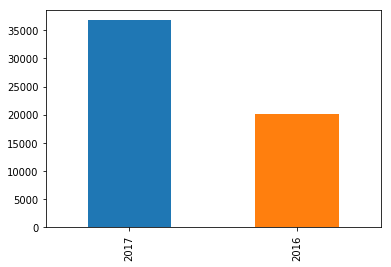

In [474]:
nyc["New_Sale_Date"].value_counts().plot(kind='bar')


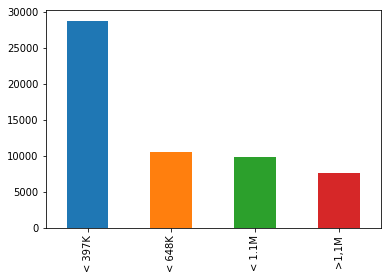

In [475]:
nyc["New_Sales_Price"].value_counts().plot(kind='bar')

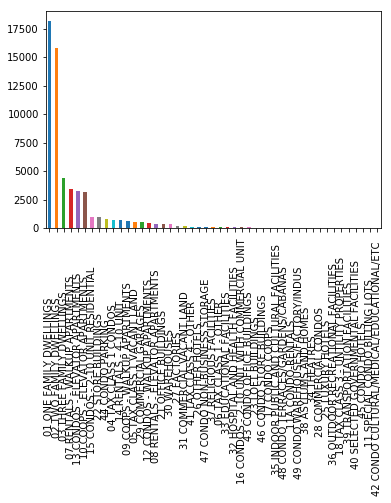

In [476]:
nyc["BUILDING_CLASS_CATEGORY"].value_counts().plot(kind='bar')

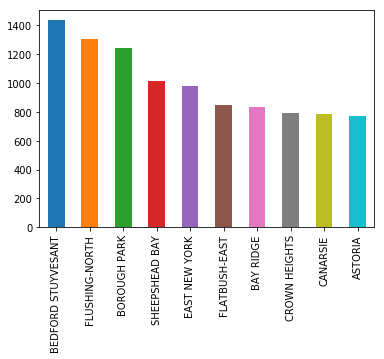

In [540]:
#Let's see if there is anything in particular with my variables
nyc["NEIGHBORHOOD"].value_counts().head(10).plot(kind='bar')



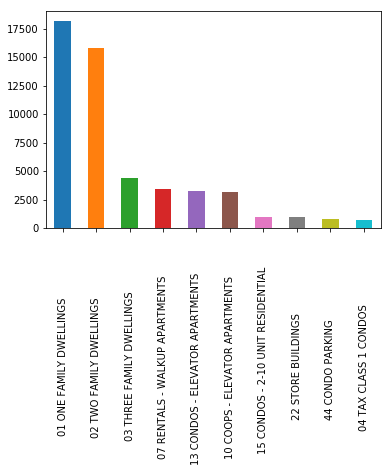

In [541]:
nyc["BUILDING_CLASS_CATEGORY"].value_counts().head(10).plot(kind='bar')

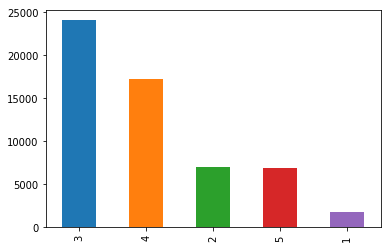

In [542]:
nyc['BOROUGH'].value_counts().plot(kind='bar')

In [480]:
neighborhood_slprice = pd.crosstab(nyc["NEIGHBORHOOD"], nyc["New_Sales_Price"])
neighborhood_slprice

New_Sales_Price,< 1.1M,< 397K,< 648K,">1,1M"
NEIGHBORHOOD,,,,
AIRPORT LA GUARDIA,2,2,0,1
ALPHABET CITY,0,9,0,11
ANNADALE,41,67,46,7
ARDEN HEIGHTS,3,147,101,0
ARROCHAR,3,16,15,1
ARROCHAR-SHORE ACRES,2,16,5,0
ARVERNE,22,123,38,0
ASTORIA,95,478,13,183
BATH BEACH,56,150,20,46


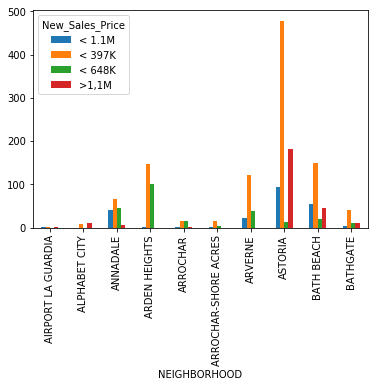

In [543]:
plt.show(neighborhood_slprice.head(10).plot(kind="bar"))

In [482]:
zip_slprice = pd.crosstab(nyc["ZIP_CODE"], nyc["New_Sales_Price"])
zip_slprice

New_Sales_Price,< 1.1M,< 397K,< 648K,">1,1M"
ZIP_CODE,,,,
0,78,203,41,72
10001,0,21,0,21
10002,0,20,0,29
10003,0,38,2,30
10004,0,1,0,2
10005,0,0,0,5
10006,0,0,0,1
10007,0,3,0,2
10009,0,15,0,16


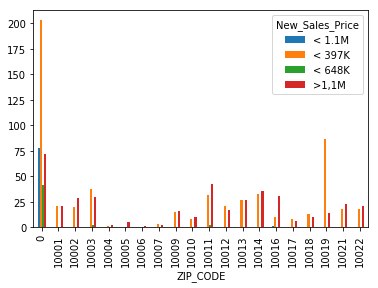

In [544]:
plt.show(zip_slprice.head(20).plot(kind="bar"))

In [484]:
# It seems that the majority of my data seems to be concentrated in one, two and three family dwellings.
build_slprice = pd.crosstab(nyc["BUILDING_CLASS_CATEGORY"], nyc["New_Sales_Price"])
build_slprice


New_Sales_Price,< 1.1M,< 397K,< 648K,">1,1M"
BUILDING_CLASS_CATEGORY,,,,
01 ONE FAMILY DWELLINGS,3200,8841,5105,1016
02 TWO FAMILY DWELLINGS,3472,7603,3086,1611
03 THREE FAMILY DWELLINGS,720,2365,518,777
04 TAX CLASS 1 CONDOS,154,362,145,78
05 TAX CLASS 1 VACANT LAND,31,412,37,50
06 TAX CLASS 1 - OTHER,3,78,3,8
07 RENTALS - WALKUP APARTMENTS,271,1831,154,1203
08 RENTALS - ELEVATOR APARTMENTS,0,179,2,196
09 COOPS - WALKUP APARTMENTS,122,285,123,90


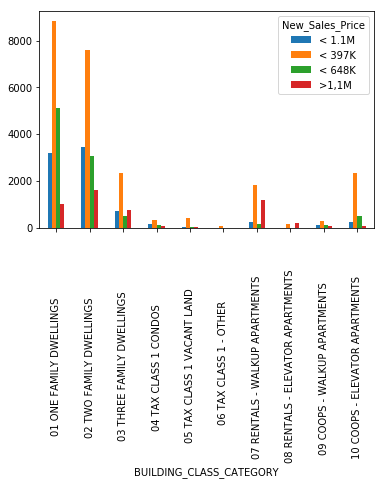

In [545]:
plt.show(build_slprice.head(10).plot(kind="bar"))
# From this plot I gather that the majority of the family dwellings building type, their sale value is concentrated between $0 -  $648K.

In [486]:
# There are some variables that are $0 or $1, I will take them out from my dataset and put a minimum of 50K for Sale Price.
real_price = nyc['SALE_PRICE'] > 49999
nyc_real = nyc[real_price]
nyc_real.shape 

(36497, 18)

So, After having 84,548 observations, I ended up with 36,497 after taking all the null values from all the columns.

In [487]:
nyc_records = nyc_real[['BOROUGH','NEIGHBORHOOD','BUILDING_CLASS_CATEGORY','TAX_CLASS_AT_PRESENT','BLOCK','LOT','ZIP_CODE', 'RESIDENTIAL_UNITS', 'COMMERCIAL_UNITS', 'TOTAL_UNITS', 'LAND_SQUARE_FEET', 'GROSS_SQUARE_FEET', 'YEAR_BUILT', 'TAX_CLASS_AT_TIME_OF_SALE', 'New_Sale_Date']]
nyc_records.head()

,BOROUGH,NEIGHBORHOOD,BUILDING_CLASS_CATEGORY,TAX_CLASS_AT_PRESENT,BLOCK,LOT,ZIP_CODE,RESIDENTIAL_UNITS,COMMERCIAL_UNITS,TOTAL_UNITS,LAND_SQUARE_FEET,GROSS_SQUARE_FEET,YEAR_BUILT,TAX_CLASS_AT_TIME_OF_SALE,New_Sale_Date
0,1,ALPHABET CITY,07 RENTALS - WALKUP APARTMENTS,2A,392,6,10009,5,0,5,1633.0,6440.0,1900,2,2017
3,1,ALPHABET CITY,07 RENTALS - WALKUP APARTMENTS,2B,402,21,10009,10,0,10,2272.0,6794.0,1913,2,2016
4,1,ALPHABET CITY,07 RENTALS - WALKUP APARTMENTS,2A,404,55,10009,6,0,6,2369.0,4615.0,1900,2,2016
6,1,ALPHABET CITY,07 RENTALS - WALKUP APARTMENTS,2B,406,32,10009,8,0,8,1750.0,4226.0,1920,2,2016
9,1,ALPHABET CITY,08 RENTALS - ELEVATOR APARTMENTS,2,387,153,10009,24,0,24,4489.0,18523.0,1920,2,2016


In [488]:
nyc_target = nyc_real.New_Sales_Price
nyc_target.head(10)

0      >1,1M
3      >1,1M
4      >1,1M
6      >1,1M
9      >1,1M
11     >1,1M
22     >1,1M
172    >1,1M
173    >1,1M
174    >1,1M
Name: New_Sales_Price, dtype: object

In [489]:
# So after cleaning out my data from empty columns, or columns that did not make too much sense to use in our analysis.
# We can see a total of 36,497 observations, and 15 columns, and 1 target variable which is my New Sale price.
nyc_records.shape

(36497, 15)

In [490]:
# Now, I will start converting my columns into dummy variables.
nyc_records_dumm = pd.get_dummies(nyc_records)
nyc_records_dumm.head(10)

,BOROUGH,BLOCK,LOT,ZIP_CODE,RESIDENTIAL_UNITS,COMMERCIAL_UNITS,TOTAL_UNITS,LAND_SQUARE_FEET,GROSS_SQUARE_FEET,YEAR_BUILT,TAX_CLASS_AT_TIME_OF_SALE,New_Sale_Date,NEIGHBORHOOD_AIRPORT LA GUARDIA,NEIGHBORHOOD_ALPHABET CITY,NEIGHBORHOOD_ANNADALE,NEIGHBORHOOD_ARDEN HEIGHTS,NEIGHBORHOOD_ARROCHAR,NEIGHBORHOOD_ARROCHAR-SHORE ACRES,NEIGHBORHOOD_ARVERNE,NEIGHBORHOOD_ASTORIA,NEIGHBORHOOD_BATH BEACH,NEIGHBORHOOD_BATHGATE,NEIGHBORHOOD_BAY RIDGE,NEIGHBORHOOD_BAYCHESTER,NEIGHBORHOOD_BAYSIDE,NEIGHBORHOOD_BEDFORD PARK/NORWOOD,NEIGHBORHOOD_BEDFORD STUYVESANT,NEIGHBORHOOD_BEECHHURST,NEIGHBORHOOD_BELLE HARBOR,NEIGHBORHOOD_BELLEROSE,NEIGHBORHOOD_BELMONT,NEIGHBORHOOD_BENSONHURST,NEIGHBORHOOD_BERGEN BEACH,NEIGHBORHOOD_BOERUM HILL,NEIGHBORHOOD_BOROUGH PARK,NEIGHBORHOOD_BRIARWOOD,NEIGHBORHOOD_BRIGHTON BEACH,NEIGHBORHOOD_BROAD CHANNEL,NEIGHBORHOOD_BRONX PARK,NEIGHBORHOOD_BRONXDALE,NEIGHBORHOOD_BROOKLYN HEIGHTS,NEIGHBORHOOD_BROWNSVILLE,NEIGHBORHOOD_BULLS HEAD,NEIGHBORHOOD_BUSH TERMINAL,NEIGHBORHOOD_BUSHWICK,NEIGHBORHOOD_CAMBRIA HEIGHTS,NEIGHBORHOOD_CANARSIE,NEIGHBORHOOD_CARROLL GARDENS,NEIGHBORHOOD_CASTLE HILL/UNIONPORT,NEIGHBORHOOD_CASTLETON CORNERS,NEIGHBORHOOD_CHELSEA,NEIGHBORHOOD_CHINATOWN,NEIGHBORHOOD_CITY ISLAND,NEIGHBORHOOD_CITY ISLAND-PELHAM STRIP,NEIGHBORHOOD_CIVIC CENTER,NEIGHBORHOOD_CLINTON,NEIGHBORHOOD_CLINTON HILL,NEIGHBORHOOD_CLOVE LAKES,NEIGHBORHOOD_CO-OP CITY,NEIGHBORHOOD_COBBLE HILL,NEIGHBORHOOD_COBBLE HILL-WEST,NEIGHBORHOOD_COLLEGE POINT,NEIGHBORHOOD_CONCORD,NEIGHBORHOOD_CONCORD-FOX HILLS,NEIGHBORHOOD_CONEY ISLAND,NEIGHBORHOOD_CORONA,NEIGHBORHOOD_COUNTRY CLUB,NEIGHBORHOOD_CROTONA PARK,NEIGHBORHOOD_CROWN HEIGHTS,NEIGHBORHOOD_CYPRESS HILLS,NEIGHBORHOOD_DONGAN HILLS,NEIGHBORHOOD_DONGAN HILLS-COLONY,NEIGHBORHOOD_DONGAN HILLS-OLD TOWN,NEIGHBORHOOD_DOUGLASTON,NEIGHBORHOOD_DOWNTOWN-FULTON FERRY,NEIGHBORHOOD_DOWNTOWN-FULTON MALL,NEIGHBORHOOD_DOWNTOWN-METROTECH,NEIGHBORHOOD_DYKER HEIGHTS,NEIGHBORHOOD_EAST ELMHURST,NEIGHBORHOOD_EAST NEW YORK,NEIGHBORHOOD_EAST RIVER,NEIGHBORHOOD_EAST TREMONT,NEIGHBORHOOD_EAST VILLAGE,NEIGHBORHOOD_ELMHURST,NEIGHBORHOOD_ELTINGVILLE,NEIGHBORHOOD_EMERSON HILL,NEIGHBORHOOD_FAR ROCKAWAY,NEIGHBORHOOD_FASHION,NEIGHBORHOOD_FIELDSTON,NEIGHBORHOOD_FINANCIAL,NEIGHBORHOOD_FLATBUSH-CENTRAL,NEIGHBORHOOD_FLATBUSH-EAST,NEIGHBORHOOD_FLATBUSH-LEFFERTS GARDEN,NEIGHBORHOOD_FLATBUSH-NORTH,NEIGHBORHOOD_FLATIRON,NEIGHBORHOOD_FLATLANDS,NEIGHBORHOOD_FLORAL PARK,NEIGHBORHOOD_FLUSHING-NORTH,NEIGHBORHOOD_FLUSHING-SOUTH,NEIGHBORHOOD_FORDHAM,NEIGHBORHOOD_FOREST HILLS,NEIGHBORHOOD_FORT GREENE,NEIGHBORHOOD_FRESH KILLS,NEIGHBORHOOD_FRESH MEADOWS,NEIGHBORHOOD_GERRITSEN BEACH,NEIGHBORHOOD_GLEN OAKS,NEIGHBORHOOD_GLENDALE,NEIGHBORHOOD_GOWANUS,NEIGHBORHOOD_GRAMERCY,NEIGHBORHOOD_GRANT CITY,NEIGHBORHOOD_GRASMERE,NEIGHBORHOOD_GRAVESEND,NEIGHBORHOOD_GREAT KILLS,NEIGHBORHOOD_GREAT KILLS-BAY TERRACE,NEIGHBORHOOD_GREENPOINT,NEIGHBORHOOD_GREENWICH VILLAGE-CENTRAL,NEIGHBORHOOD_GREENWICH VILLAGE-WEST,NEIGHBORHOOD_GRYMES HILL,NEIGHBORHOOD_HAMMELS,NEIGHBORHOOD_HARLEM-CENTRAL,NEIGHBORHOOD_HARLEM-EAST,NEIGHBORHOOD_HARLEM-UPPER,NEIGHBORHOOD_HARLEM-WEST,NEIGHBORHOOD_HIGHBRIDGE/MORRIS HEIGHTS,NEIGHBORHOOD_HILLCREST,NEIGHBORHOOD_HOLLIS,NEIGHBORHOOD_HOLLIS HILLS,NEIGHBORHOOD_HOLLISWOOD,NEIGHBORHOOD_HOWARD BEACH,NEIGHBORHOOD_HUGUENOT,NEIGHBORHOOD_HUNTS POINT,NEIGHBORHOOD_INWOOD,NEIGHBORHOOD_JACKSON HEIGHTS,NEIGHBORHOOD_JAMAICA,NEIGHBORHOOD_JAMAICA BAY,NEIGHBORHOOD_JAMAICA ESTATES,NEIGHBORHOOD_JAMAICA HILLS,NEIGHBORHOOD_JAVITS CENTER,NEIGHBORHOOD_KENSINGTON,NEIGHBORHOOD_KEW GARDENS,NEIGHBORHOOD_KINGSBRIDGE HTS/UNIV HTS,NEIGHBORHOOD_KINGSBRIDGE/JEROME PARK,NEIGHBORHOOD_KIPS BAY,NEIGHBORHOOD_LAURELTON,NEIGHBORHOOD_LITTLE ITALY,NEIGHBORHOOD_LITTLE NECK,NEIGHBORHOOD_LIVINGSTON,NEIGHBORHOOD_LONG ISLAND CITY,NEIGHBORHOOD_LOWER EAST SIDE,NEIGHBORHOOD_MADISON,NEIGHBORHOOD_MANHATTAN BEACH,NEIGHBORHOOD_MANHATTAN VALLEY,NEIGHBORHOOD_MANOR HEIGHTS,NEIGHBORHOOD_MARINE PARK,NEIGHBORHOOD_MARINERS HARBOR,NEIGHBORHOOD_MASPETH,NEIGHBORHOOD_MELROSE/CONCOURSE,NEIGHBORHOOD_MIDDLE VILLAGE,NEIG

In [491]:
# So, after we converted the columns into dummy variables we have a total of 328 columns and 36,497 rows (should be the same always).
nyc_records_dumm.shape

(36497, 317)

In [492]:
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

In [493]:
nyc_records_dumm.describe().T

,count,mean,std,min,25%,50%,75%,max
BOROUGH,36497.0,3.377510,0.961140,1.0,3.0,3.0,4.0,5.0
BLOCK,36497.0,5139.899197,3632.526621,1.0,2135.0,4681.0,7273.0,16319.0
LOT,36497.0,222.704441,476.392856,1.0,21.0,44.0,93.0,7501.0
ZIP_CODE,36497.0,10944.771488,990.569763,0.0,10466.0,11218.0,11358.0,11694.0
RESIDENTIAL_UNITS,36497.0,2.455791,17.762742,0.0,1.0,1.0,2.0,1844.0
COMMERCIAL_UNITS,36497.0,0.258405,12.565656,0.0,0.0,0.0,0.0,2261.0
TOTAL_UNITS,36497.0,2.717621,21.883746,0.0,1.0,1.0,2.0,2261.0
LAND_SQUARE_FEET,36497.0,3375.013837,33786.265730,0.0,1395.0,2200.0,3267.0,4228300.0
GROSS_SQUARE_FEET,36497.0,3410.462257,29842.805334,0.0,881.0,1550.0,2340.0,3750565.0
YEAR_BUILT,36497.0,1855.065403,411.992621,0.0,1920.0,1931.0,1962.0,2017.0


In [494]:
# Check the correlation between each variable

corr_matrix = nyc_records_dumm.corr()
corr_matrix

,BOROUGH,BLOCK,LOT,ZIP_CODE,RESIDENTIAL_UNITS,COMMERCIAL_UNITS,TOTAL_UNITS,LAND_SQUARE_FEET,GROSS_SQUARE_FEET,YEAR_BUILT,TAX_CLASS_AT_TIME_OF_SALE,New_Sale_Date,NEIGHBORHOOD_AIRPORT LA GUARDIA,NEIGHBORHOOD_ALPHABET CITY,NEIGHBORHOOD_ANNADALE,NEIGHBORHOOD_ARDEN HEIGHTS,NEIGHBORHOOD_ARROCHAR,NEIGHBORHOOD_ARROCHAR-SHORE ACRES,NEIGHBORHOOD_ARVERNE,NEIGHBORHOOD_ASTORIA,NEIGHBORHOOD_BATH BEACH,NEIGHBORHOOD_BATHGATE,NEIGHBORHOOD_BAY RIDGE,NEIGHBORHOOD_BAYCHESTER,NEIGHBORHOOD_BAYSIDE,NEIGHBORHOOD_BEDFORD PARK/NORWOOD,NEIGHBORHOOD_BEDFORD STUYVESANT,NEIGHBORHOOD_BEECHHURST,NEIGHBORHOOD_BELLE HARBOR,NEIGHBORHOOD_BELLEROSE,NEIGHBORHOOD_BELMONT,NEIGHBORHOOD_BENSONHURST,NEIGHBORHOOD_BERGEN BEACH,NEIGHBORHOOD_BOERUM HILL,NEIGHBORHOOD_BOROUGH PARK,NEIGHBORHOOD_BRIARWOOD,NEIGHBORHOOD_BRIGHTON BEACH,NEIGHBORHOOD_BROAD CHANNEL,NEIGHBORHOOD_BRONX PARK,NEIGHBORHOOD_BRONXDALE,NEIGHBORHOOD_BROOKLYN HEIGHTS,NEIGHBORHOOD_BROWNSVILLE,NEIGHBORHOOD_BULLS HEAD,NEIGHBORHOOD_BUSH TERMINAL,NEIGHBORHOOD_BUSHWICK,NEIGHBORHOOD_CAMBRIA HEIGHTS,NEIGHBORHOOD_CANARSIE,NEIGHBORHOOD_CARROLL GARDENS,NEIGHBORHOOD_CASTLE HILL/UNIONPORT,NEIGHBORHOOD_CASTLETON CORNERS,NEIGHBORHOOD_CHELSEA,NEIGHBORHOOD_CHINATOWN,NEIGHBORHOOD_CITY ISLAND,NEIGHBORHOOD_CITY ISLAND-PELHAM STRIP,NEIGHBORHOOD_CIVIC CENTER,NEIGHBORHOOD_CLINTON,NEIGHBORHOOD_CLINTON HILL,NEIGHBORHOOD_CLOVE LAKES,NEIGHBORHOOD_CO-OP CITY,NEIGHBORHOOD_COBBLE HILL,NEIGHBORHOOD_COBBLE HILL-WEST,NEIGHBORHOOD_COLLEGE POINT,NEIGHBORHOOD_CONCORD,NEIGHBORHOOD_CONCORD-FOX HILLS,NEIGHBORHOOD_CONEY ISLAND,NEIGHBORHOOD_CORONA,NEIGHBORHOOD_COUNTRY CLUB,NEIGHBORHOOD_CROTONA PARK,NEIGHBORHOOD_CROWN HEIGHTS,NEIGHBORHOOD_CYPRESS HILLS,NEIGHBORHOOD_DONGAN HILLS,NEIGHBORHOOD_DONGAN HILLS-COLONY,NEIGHBORHOOD_DONGAN HILLS-OLD TOWN,NEIGHBORHOOD_DOUGLASTON,NEIGHBORHOOD_DOWNTOWN-FULTON FERRY,NEIGHBORHOOD_DOWNTOWN-FULTON MALL,NEIGHBORHOOD_DOWNTOWN-METROTECH,NEIGHBORHOOD_DYKER HEIGHTS,NEIGHBORHOOD_EAST ELMHURST,NEIGHBORHOOD_EAST NEW YORK,NEIGHBORHOOD_EAST RIVER,NEIGHBORHOOD_EAST TREMONT,NEIGHBORHOOD_EAST VILLAGE,NEIGHBORHOOD_ELMHURST,NEIGHBORHOOD_ELTINGVILLE,NEIGHBORHOOD_EMERSON HILL,NEIGHBORHOOD_FAR ROCKAWAY,NEIGHBORHOOD_FASHION,NEIGHBORHOOD_FIELDSTON,NEIGHBORHOOD_FINANCIAL,NEIGHBORHOOD_FLATBUSH-CENTRAL,NEIGHBORHOOD_FLATBUSH-EAST,NEIGHBORHOOD_FLATBUSH-LEFFERTS GARDEN,NEIGHBORHOOD_FLATBUSH-NORTH,NEIGHBORHOOD_FLATIRON,NEIGHBORHOOD_FLATLANDS,NEIGHBORHOOD_FLORAL PARK,NEIGHBORHOOD_FLUSHING-NORTH,NEIGHBORHOOD_FLUSHING-SOUTH,NEIGHBORHOOD_FORDHAM,NEIGHBORHOOD_FOREST HILLS,NEIGHBORHOOD_FORT GREENE,NEIGHBORHOOD_FRESH KILLS,NEIGHBORHOOD_FRESH MEADOWS,NEIGHBORHOOD_GERRITSEN BEACH,NEIGHBORHOOD_GLEN OAKS,NEIGHBORHOOD_GLENDALE,NEIGHBORHOOD_GOWANUS,NEIGHBORHOOD_GRAMERCY,NEIGHBORHOOD_GRANT CITY,NEIGHBORHOOD_GRASMERE,NEIGHBORHOOD_GRAVESEND,NEIGHBORHOOD_GREAT KILLS,NEIGHBORHOOD_GREAT KILLS-BAY TERRACE,NEIGHBORHOOD_GREENPOINT,NEIGHBORHOOD_GREENWICH VILLAGE-CENTRAL,NEIGHBORHOOD_GREENWICH VILLAGE-WEST,NEIGHBORHOOD_GRYMES HILL,NEIGHBORHOOD_HAMMELS,NEIGHBORHOOD_HARLEM-CENTRAL,NEIGHBORHOOD_HARLEM-EAST,NEIGHBORHOOD_HARLEM-UPPER,NEIGHBORHOOD_HARLEM-WEST,NEIGHBORHOOD_HIGHBRIDGE/MORRIS HEIGHTS,NEIGHBORHOOD_HILLCREST,NEIGHBORHOOD_HOLLIS,NEIGHBORHOOD_HOLLIS HILLS,NEIGHBORHOOD_HOLLISWOOD,NEIGHBORHOOD_HOWARD BEACH,NEIGHBORHOOD_HUGUENOT,NEIGHBORHOOD_HUNTS POINT,NEIGHBORHOOD_INWOOD,NEIGHBORHOOD_JACKSON HEIGHTS,NEIGHBORHOOD_JAMAICA,NEIGHBORHOOD_JAMAICA BAY,NEIGHBORHOOD_JAMAICA ESTATES,NEIGHBORHOOD_JAMAICA HILLS,NEIGHBORHOOD_JAVITS CENTER,NEIGHBORHOOD_KENSINGTON,NEIGHBORHOOD_KEW GARDENS,NEIGHBORHOOD_KINGSBRIDGE HTS/UNIV HTS,NEIGHBORHOOD_KINGSBRIDGE/JEROME PARK,NEIGHBORHOOD_KIPS BAY,NEIGHBORHOOD_LAURELTON,NEIGHBORHOOD_LITTLE ITALY,NEIGHBORHOOD_LITTLE NECK,NEIGHBORHOOD_LIVINGSTON,NEIGHBORHOOD_LONG ISLAND CITY,NEIGHBORHOOD_LOWER EAST SIDE,NEIGHBORHOOD_MADISON,NEIGHBORHOOD_MANHATTAN BEACH,NEIGHBORHOOD_MANHATTAN VALLEY,NEIGHBORHOOD_MANOR HEIGHTS,NEIGHBORHOOD_MARINE PARK,NEIGHBORHOOD_MARINERS HARBOR,NEIGHBORHOOD_MASPETH,NEIGHBORHOOD_MELROSE/CONCOURSE,NEIGHBORHOOD_MIDDLE VILLAGE,NEIG

Splitting into Training and Testing

In [495]:
# Now, let's split our data into Training and Testing
from sklearn.model_selection import train_test_split
nyc_train, nyc_test, nyc_target_train, nyc_target_test = train_test_split(nyc_records_dumm, nyc_target, test_size=0.2, random_state=55)

print(nyc_train.shape)# perfect, this is the amount of variables we were looking for.
print(nyc_test.shape)
print(nyc_target_train.shape)
print(nyc_target_test.shape)

(29197, 317)
(7300, 317)
(29197,)
(7300,)


Min-Max Normalization

In [496]:
from sklearn import preprocessing

In [497]:
min_max_scaler = preprocessing.MinMaxScaler().fit(nyc_train)

nyc_train_norm = min_max_scaler.transform(nyc_train)
nyc_train_norm = pd.DataFrame(nyc_train_norm, columns=nyc_train.columns, index=nyc_train.index)

nyc_test_norm = min_max_scaler.transform(nyc_test)
nyc_test_norm = pd.DataFrame(nyc_test_norm, columns=nyc_test.columns, index=nyc_test.index)

/Users/elssieguerra/anaconda3/lib/python3.7/site-packages/sklearn/preprocessing/data.py:323: DataConversionWarning: Data with input dtype uint8, int64, float64 were all converted to float64 by MinMaxScaler.
  return self.partial_fit(X, y)


In [498]:
nyc_train_norm.head(5)

,BOROUGH,BLOCK,LOT,ZIP_CODE,RESIDENTIAL_UNITS,COMMERCIAL_UNITS,TOTAL_UNITS,LAND_SQUARE_FEET,GROSS_SQUARE_FEET,YEAR_BUILT,TAX_CLASS_AT_TIME_OF_SALE,New_Sale_Date,NEIGHBORHOOD_AIRPORT LA GUARDIA,NEIGHBORHOOD_ALPHABET CITY,NEIGHBORHOOD_ANNADALE,NEIGHBORHOOD_ARDEN HEIGHTS,NEIGHBORHOOD_ARROCHAR,NEIGHBORHOOD_ARROCHAR-SHORE ACRES,NEIGHBORHOOD_ARVERNE,NEIGHBORHOOD_ASTORIA,NEIGHBORHOOD_BATH BEACH,NEIGHBORHOOD_BATHGATE,NEIGHBORHOOD_BAY RIDGE,NEIGHBORHOOD_BAYCHESTER,NEIGHBORHOOD_BAYSIDE,NEIGHBORHOOD_BEDFORD PARK/NORWOOD,NEIGHBORHOOD_BEDFORD STUYVESANT,NEIGHBORHOOD_BEECHHURST,NEIGHBORHOOD_BELLE HARBOR,NEIGHBORHOOD_BELLEROSE,NEIGHBORHOOD_BELMONT,NEIGHBORHOOD_BENSONHURST,NEIGHBORHOOD_BERGEN BEACH,NEIGHBORHOOD_BOERUM HILL,NEIGHBORHOOD_BOROUGH PARK,NEIGHBORHOOD_BRIARWOOD,NEIGHBORHOOD_BRIGHTON BEACH,NEIGHBORHOOD_BROAD CHANNEL,NEIGHBORHOOD_BRONX PARK,NEIGHBORHOOD_BRONXDALE,NEIGHBORHOOD_BROOKLYN HEIGHTS,NEIGHBORHOOD_BROWNSVILLE,NEIGHBORHOOD_BULLS HEAD,NEIGHBORHOOD_BUSH TERMINAL,NEIGHBORHOOD_BUSHWICK,NEIGHBORHOOD_CAMBRIA HEIGHTS,NEIGHBORHOOD_CANARSIE,NEIGHBORHOOD_CARROLL GARDENS,NEIGHBORHOOD_CASTLE HILL/UNIONPORT,NEIGHBORHOOD_CASTLETON CORNERS,NEIGHBORHOOD_CHELSEA,NEIGHBORHOOD_CHINATOWN,NEIGHBORHOOD_CITY ISLAND,NEIGHBORHOOD_CITY ISLAND-PELHAM STRIP,NEIGHBORHOOD_CIVIC CENTER,NEIGHBORHOOD_CLINTON,NEIGHBORHOOD_CLINTON HILL,NEIGHBORHOOD_CLOVE LAKES,NEIGHBORHOOD_CO-OP CITY,NEIGHBORHOOD_COBBLE HILL,NEIGHBORHOOD_COBBLE HILL-WEST,NEIGHBORHOOD_COLLEGE POINT,NEIGHBORHOOD_CONCORD,NEIGHBORHOOD_CONCORD-FOX HILLS,NEIGHBORHOOD_CONEY ISLAND,NEIGHBORHOOD_CORONA,NEIGHBORHOOD_COUNTRY CLUB,NEIGHBORHOOD_CROTONA PARK,NEIGHBORHOOD_CROWN HEIGHTS,NEIGHBORHOOD_CYPRESS HILLS,NEIGHBORHOOD_DONGAN HILLS,NEIGHBORHOOD_DONGAN HILLS-COLONY,NEIGHBORHOOD_DONGAN HILLS-OLD TOWN,NEIGHBORHOOD_DOUGLASTON,NEIGHBORHOOD_DOWNTOWN-FULTON FERRY,NEIGHBORHOOD_DOWNTOWN-FULTON MALL,NEIGHBORHOOD_DOWNTOWN-METROTECH,NEIGHBORHOOD_DYKER HEIGHTS,NEIGHBORHOOD_EAST ELMHURST,NEIGHBORHOOD_EAST NEW YORK,NEIGHBORHOOD_EAST RIVER,NEIGHBORHOOD_EAST TREMONT,NEIGHBORHOOD_EAST VILLAGE,NEIGHBORHOOD_ELMHURST,NEIGHBORHOOD_ELTINGVILLE,NEIGHBORHOOD_EMERSON HILL,NEIGHBORHOOD_FAR ROCKAWAY,NEIGHBORHOOD_FASHION,NEIGHBORHOOD_FIELDSTON,NEIGHBORHOOD_FINANCIAL,NEIGHBORHOOD_FLATBUSH-CENTRAL,NEIGHBORHOOD_FLATBUSH-EAST,NEIGHBORHOOD_FLATBUSH-LEFFERTS GARDEN,NEIGHBORHOOD_FLATBUSH-NORTH,NEIGHBORHOOD_FLATIRON,NEIGHBORHOOD_FLATLANDS,NEIGHBORHOOD_FLORAL PARK,NEIGHBORHOOD_FLUSHING-NORTH,NEIGHBORHOOD_FLUSHING-SOUTH,NEIGHBORHOOD_FORDHAM,NEIGHBORHOOD_FOREST HILLS,NEIGHBORHOOD_FORT GREENE,NEIGHBORHOOD_FRESH KILLS,NEIGHBORHOOD_FRESH MEADOWS,NEIGHBORHOOD_GERRITSEN BEACH,NEIGHBORHOOD_GLEN OAKS,NEIGHBORHOOD_GLENDALE,NEIGHBORHOOD_GOWANUS,NEIGHBORHOOD_GRAMERCY,NEIGHBORHOOD_GRANT CITY,NEIGHBORHOOD_GRASMERE,NEIGHBORHOOD_GRAVESEND,NEIGHBORHOOD_GREAT KILLS,NEIGHBORHOOD_GREAT KILLS-BAY TERRACE,NEIGHBORHOOD_GREENPOINT,NEIGHBORHOOD_GREENWICH VILLAGE-CENTRAL,NEIGHBORHOOD_GREENWICH VILLAGE-WEST,NEIGHBORHOOD_GRYMES HILL,NEIGHBORHOOD_HAMMELS,NEIGHBORHOOD_HARLEM-CENTRAL,NEIGHBORHOOD_HARLEM-EAST,NEIGHBORHOOD_HARLEM-UPPER,NEIGHBORHOOD_HARLEM-WEST,NEIGHBORHOOD_HIGHBRIDGE/MORRIS HEIGHTS,NEIGHBORHOOD_HILLCREST,NEIGHBORHOOD_HOLLIS,NEIGHBORHOOD_HOLLIS HILLS,NEIGHBORHOOD_HOLLISWOOD,NEIGHBORHOOD_HOWARD BEACH,NEIGHBORHOOD_HUGUENOT,NEIGHBORHOOD_HUNTS POINT,NEIGHBORHOOD_INWOOD,NEIGHBORHOOD_JACKSON HEIGHTS,NEIGHBORHOOD_JAMAICA,NEIGHBORHOOD_JAMAICA BAY,NEIGHBORHOOD_JAMAICA ESTATES,NEIGHBORHOOD_JAMAICA HILLS,NEIGHBORHOOD_JAVITS CENTER,NEIGHBORHOOD_KENSINGTON,NEIGHBORHOOD_KEW GARDENS,NEIGHBORHOOD_KINGSBRIDGE HTS/UNIV HTS,NEIGHBORHOOD_KINGSBRIDGE/JEROME PARK,NEIGHBORHOOD_KIPS BAY,NEIGHBORHOOD_LAURELTON,NEIGHBORHOOD_LITTLE ITALY,NEIGHBORHOOD_LITTLE NECK,NEIGHBORHOOD_LIVINGSTON,NEIGHBORHOOD_LONG ISLAND CITY,NEIGHBORHOOD_LOWER EAST SIDE,NEIGHBORHOOD_MADISON,NEIGHBORHOOD_MANHATTAN BEACH,NEIGHBORHOOD_MANHATTAN VALLEY,NEIGHBORHOOD_MANOR HEIGHTS,NEIGHBORHOOD_MARINE PARK,NEIGHBORHOOD_MARINERS HARBOR,NEIGHBORHOOD_MASPETH,NEIGHBORHOOD_MELROSE/CONCOURSE,NEIGHBORHOOD_MIDDLE VILLAGE,NEIG

1st Model ---- KNN
#I will first use the model K-Nearest Neighbors to predict the sales price of the NYC properties that were sold throghout 2016 to 2017

In [499]:
from sklearn import neighbors, tree, naive_bayes

In [500]:
n_neighbors = 3

knnclf = neighbors.KNeighborsClassifier(n_neighbors, weights='distance')
knnclf.fit(nyc_train_norm, nyc_target_train)

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
           metric_params=None, n_jobs=None, n_neighbors=3, p=2,
           weights='distance')

In [501]:
# This predicts the Testing Dataset target.
knnpreds_test = knnclf.predict(nyc_test_norm)
print(knnpreds_test)

['>1,1M' '< 1.1M' '< 397K' ... '< 648K' '< 1.1M' '< 1.1M']


In [502]:
from sklearn.metrics import classification_report

In [503]:
print(classification_report(nyc_target_test, knnpreds_test))

              precision    recall  f1-score   support

      < 1.1M       0.54      0.55      0.55      1957
      < 397K       0.62      0.60      0.61      1696
      < 648K       0.56      0.56      0.56      2121
       >1,1M       0.70      0.71      0.70      1526

   micro avg       0.60      0.60      0.60      7300
   macro avg       0.60      0.60      0.60      7300
weighted avg       0.60      0.60      0.60      7300



In [504]:
from sklearn.metrics import confusion_matrix
knncm = confusion_matrix(nyc_target_test, knnpreds_test)
print(knncm)

[[1070  131  420  336]
 [ 157 1024  456   59]
 [ 411  454 1180   76]
 [ 327   55   59 1085]]


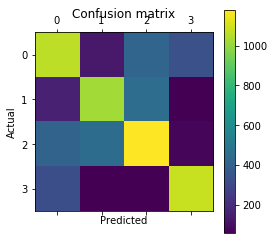

In [505]:
# This is the plot of my confusion Matrix
import pylab as plt
%matplotlib inline
plt.matshow(knncm)
plt.title('Confusion matrix')
plt.colorbar()
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.show()

In [506]:
# So the average accuracy score across the test instances is around 60%.
# The average accuracy score across the training instance is around 98.3%, so we are overfitting our model.

print(knnclf.score(nyc_test_norm, nyc_target_test))
print(knnclf.score(nyc_train_norm, nyc_target_train))

0.5971232876712329
0.9835257046956879


2nd Model ---- Decision Tree Classfier

In [507]:
# So now I will try a Decision Tree Classifier
treeclf = tree.DecisionTreeClassifier(criterion='entropy', min_samples_split=10)

In [508]:
treeclf = treeclf.fit(nyc_train, nyc_target_train)

In [509]:
treepreds_test = treeclf.predict(nyc_test)
print(treepreds_test)

['>1,1M' '< 648K' '< 397K' ... '>1,1M' '< 1.1M' '< 1.1M']


In [510]:
# So, let's see what's the average accuracy across the test instance
# Which is a little bit better than KNN.
print(treeclf.score(nyc_test, nyc_target_test))

0.602054794520548


In [511]:
# The Train model has an average accuracy of 85.89%.
# This indicates that there is overfitting in my model. 
print(treeclf.score(nyc_train, nyc_target_train))

0.8592663629824983


In [512]:
# The weighted average score of precision across my decision tree model is 60%.
print(classification_report(nyc_target_test, treepreds_test))

              precision    recall  f1-score   support

      < 1.1M       0.54      0.59      0.57      1957
      < 397K       0.61      0.61      0.61      1696
      < 648K       0.56      0.54      0.55      2121
       >1,1M       0.73      0.70      0.71      1526

   micro avg       0.60      0.60      0.60      7300
   macro avg       0.61      0.61      0.61      7300
weighted avg       0.60      0.60      0.60      7300



In [513]:
# Confusion Matrix
treecm = confusion_matrix(nyc_target_test, treepreds_test)
print(treecm)

[[1152  134  364  307]
 [ 152 1033  465   46]
 [ 440  491 1139   51]
 [ 371   31   53 1071]]


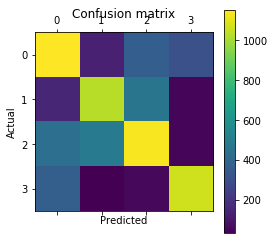

In [514]:
# This is the plot of my confusion Matrix
import pylab as plt
%matplotlib inline
plt.matshow(treecm)
plt.title('Confusion matrix')
plt.colorbar()
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.show()

In [515]:
tree = export_graphviz(treeclf,out_file='tree.dot', feature_names=nyc_train.columns, class_names=['>1,1M','< 397K','< 648K','< 1.1M'])

import graphviz

with open("tree.dot") as f:
    dot_graph = f.read()
graphviz.Source(dot_graph, format="png")

3rd Model ---- Gaussian Naive Bayers Classifier

In [516]:
# Finally, I will try the Gaussian Naive Bayers Classifier
nbclf = naive_bayes.GaussianNB()
nbclf = nbclf.fit(nyc_train, nyc_target_train)
nbpreds_test = nbclf.predict(nyc_test)
print(nbpreds_test)

['< 1.1M' '< 1.1M' '< 1.1M' ... '< 1.1M' '< 1.1M' '< 1.1M']


In [517]:
# This score is super low, compared to my other two models. I will definitely will not further continue with this model.
print(nbclf.score(nyc_train, nyc_target_train))

0.28787204164811453


In [518]:
# The score for Test, is super low.
print(nbclf.score(nyc_test, nyc_target_test))

0.283972602739726


In [519]:
print(classification_report(nyc_target_test, nbpreds_test))

              precision    recall  f1-score   support

      < 1.1M       0.28      0.97      0.43      1957
      < 397K       0.29      0.05      0.09      1696
      < 648K       0.03      0.00      0.00      2121
       >1,1M       0.73      0.05      0.10      1526

   micro avg       0.28      0.28      0.28      7300
   macro avg       0.33      0.27      0.16      7300
weighted avg       0.30      0.28      0.16      7300



In [520]:
Naive = confusion_matrix(nyc_target_test, nbpreds_test)
print(Naive)

[[1900   51    0    6]
 [1586   89    2   19]
 [2073   41    2    5]
 [1258  128   58   82]]


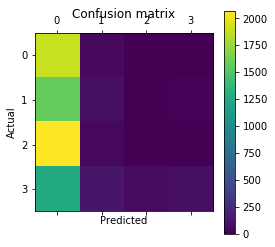

In [521]:
# This is the plot of my confusion Matrix
import pylab as plt
%matplotlib inline
plt.matshow(Naive)
plt.title('Confusion matrix')
plt.colorbar()
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.show()

4th Model ---- Linear Discriminant Analysis

In [522]:
# I will also try the Linear Discriminant Analysis 
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis

ldclf = LinearDiscriminantAnalysis()
ldclf = ldclf.fit(nyc_train, nyc_target_train)
ldpreds_test = ldclf.predict(nyc_test)
print(ldpreds_test)

['>1,1M' '< 648K' '< 648K' ... '>1,1M' '< 1.1M' '< 1.1M']


/Users/elssieguerra/anaconda3/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


In [523]:
print(ldclf.score(nyc_train, nyc_target_train))
# The score for my training model is a little bit lower compared to the other 2 models (Decision Tree and KNN).

0.604171661472069


In [524]:
print(ldclf.score(nyc_test, nyc_target_test)) # Similar to my other 2 models (Decision Tree and KNN) as well.

0.5976712328767123


In [525]:
# The weighted average score of precision across my decision tree model is 60%.
print(classification_report(nyc_target_test, ldpreds_test))

              precision    recall  f1-score   support

      < 1.1M       0.54      0.56      0.55      1957
      < 397K       0.66      0.53      0.59      1696
      < 648K       0.55      0.63      0.58      2121
       >1,1M       0.70      0.69      0.69      1526

   micro avg       0.60      0.60      0.60      7300
   macro avg       0.61      0.60      0.60      7300
weighted avg       0.60      0.60      0.60      7300



My weighted average score for precision is 60%, which is pretty ok for my test set. This number is similar also to my KNN and Decision Tree model.

In [526]:
LDA = confusion_matrix(nyc_target_test, ldpreds_test)
print(LDA)

[[1095  107  459  296]
 [ 129  894  602   71]
 [ 389  319 1328   85]
 [ 418   27   35 1046]]


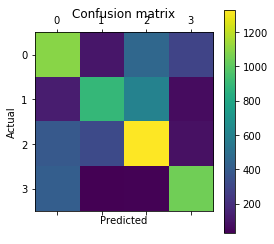

In [527]:
# This is the plot of my confusion Matrix
import pylab as plt
%matplotlib inline
plt.matshow(LDA)
plt.title('Confusion matrix')
plt.colorbar()
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.show()

Unsupervised Learning

In [528]:
# Perform PCA to reduce dimensions in NYC_TRAIN_NORM
from sklearn import decomposition

In [529]:
# 1 component
#If we used only 1 component it explains only 82% of the variance in my data.
pca = decomposition.PCA(n_components=1)
trans = pca.fit(nyc_records_dumm).transform(nyc_records_dumm)
print(pca.explained_variance_ratio_)
print(pca.explained_variance_ratio_.sum())

[0.82836759]
0.8283675942567031


In [530]:
# 2 component
#If we used only 2 component it explains only 99% of the variance in my data.
pca = decomposition.PCA(n_components=2)
trans = pca.fit(nyc_records_dumm).transform(nyc_records_dumm)
print(pca.explained_variance_ratio_)
print(pca.explained_variance_ratio_.sum())

[0.82836759 0.16453689]
0.992904486650733


In [531]:
trans.shape #We have a total of 36,497 observations and 2 Principal Components.

(36497, 2)

In [532]:
# split lower dimensional transformed data into training and test sets
nyc_train_pca, nyc_test_pca, nyc_target_train_pca, nyc_target_test_pca = train_test_split(trans, nyc_target, test_size=0.2, random_state=55)

In [533]:
print(nyc_train_pca.shape)# perfect, this is the amount of variables we were looking for.
print(nyc_test_pca.shape)
print(nyc_target_train_pca.shape)
print(nyc_target_test_pca.shape)

(29197, 2)
(7300, 2)
(29197,)
(7300,)


In [534]:
# Perform K-NN again but with PCA results
n_neighbors = 3

knnclf = neighbors.KNeighborsClassifier(n_neighbors, weights='distance')
knnclf.fit(nyc_train_pca, nyc_target_train_pca)

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
           metric_params=None, n_jobs=None, n_neighbors=3, p=2,
           weights='distance')

In [535]:
 #This predicts the Testing Dataset target.
knnpreds_test = knnclf.predict(nyc_test_pca)
print(knnpreds_test)

['>1,1M' '< 648K' '< 648K' ... '< 1.1M' '< 648K' '< 1.1M']


In [536]:
print(classification_report(nyc_target_test_pca, knnpreds_test))


              precision    recall  f1-score   support

      < 1.1M       0.43      0.45      0.44      1957
      < 397K       0.54      0.52      0.53      1696
      < 648K       0.46      0.47      0.46      2121
       >1,1M       0.62      0.61      0.61      1526

   micro avg       0.50      0.50      0.50      7300
   macro avg       0.51      0.51      0.51      7300
weighted avg       0.50      0.50      0.50      7300



In [537]:
# Using 2 principal components, instead of the 300+ columns, still gave us good results such as 50% Precision for the Test.


In [549]:
# Now I will use the PCA in my Decision Tree to see if this affect my answer:

from sklearn import tree
treeclf = tree.DecisionTreeClassifier(criterion='entropy', min_samples_split=10)

In [550]:
treeclf = treeclf.fit(nyc_train_pca, nyc_target_train)

In [551]:
treepreds_test = treeclf.predict(nyc_test_pca)
print(treepreds_test)

['>1,1M' '< 1.1M' '< 397K' ... '< 1.1M' '< 1.1M' '< 1.1M']


In [552]:
print(treeclf.score(nyc_test_pca, nyc_target_test))

0.48


In [553]:
# The Train model has an average accuracy of 85.89%.
# This indicates that there is overfitting in my model. 
print(treeclf.score(nyc_train_pca, nyc_target_train))

0.760386341062438


Values seems to be lower but it could be because PCA removes the multicollinearity between the variables.The multicollinearity can affecta my score by inflating it.

Clustering

In [554]:
from sklearn.cluster import KMeans 

In [555]:
nyc_kmeans = KMeans(n_clusters=4, max_iter=500, verbose=1, n_init=5) # initialization
nyc_kmeans.fit(nyc_train_norm)

Initialization complete
start iteration
done sorting
end inner loop
Iteration 0, inertia 61560.7135244808
start iteration
done sorting
end inner loop
Iteration 1, inertia 59769.35526238674
start iteration
done sorting
end inner loop
Iteration 2, inertia 58866.99321696177
start iteration
done sorting
end inner loop
Iteration 3, inertia 58866.99321696177
center shift 0.000000e+00 within tolerance 8.642731e-07
Initialization complete
start iteration
done sorting
end inner loop
Iteration 0, inertia 57983.07388382598
start iteration
done sorting
end inner loop
Iteration 1, inertia 55146.116107421694
start iteration
done sorting
end inner loop
Iteration 2, inertia 55049.473788884454
start iteration
done sorting
end inner loop
Iteration 3, inertia 55049.473788884454
center shift 0.000000e+00 within tolerance 8.642731e-07
Initialization complete
start iteration
done sorting
end inner loop
Iteration 0, inertia 58917.49895155158
start iteration
done sorting
end inner loop
Iteration 1, inertia 56

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=500,
    n_clusters=4, n_init=5, n_jobs=None, precompute_distances='auto',
    random_state=None, tol=0.0001, verbose=1)

In [556]:
c = nyc_kmeans.predict(nyc_test_norm)

In [557]:
c.shape

(7300,)

In [558]:
def cluster_sizes(clusters):
    #clusters is an array of cluster labels for each instance in the data
    
    size = {}
    cluster_labels = np.unique(clusters)
    n_clusters = cluster_labels.shape[0]

    for c in cluster_labels:
        size[c] = len(nyc_test_norm[clusters == c])
    return size

In [559]:
size = cluster_sizes(c)

for i in size.keys():
    print("Size of Cluster", i, "= ", size[i])

Size of Cluster 0 =  1041
Size of Cluster 1 =  1875
Size of Cluster 2 =  2405
Size of Cluster 3 =  1979


In [560]:
nyc_centroids = pd.DataFrame(nyc_kmeans.cluster_centers_, columns=nyc_train_norm.columns)
nyc_centroids

,BOROUGH,BLOCK,LOT,ZIP_CODE,RESIDENTIAL_UNITS,COMMERCIAL_UNITS,TOTAL_UNITS,LAND_SQUARE_FEET,GROSS_SQUARE_FEET,YEAR_BUILT,TAX_CLASS_AT_TIME_OF_SALE,New_Sale_Date,NEIGHBORHOOD_AIRPORT LA GUARDIA,NEIGHBORHOOD_ALPHABET CITY,NEIGHBORHOOD_ANNADALE,NEIGHBORHOOD_ARDEN HEIGHTS,NEIGHBORHOOD_ARROCHAR,NEIGHBORHOOD_ARROCHAR-SHORE ACRES,NEIGHBORHOOD_ARVERNE,NEIGHBORHOOD_ASTORIA,NEIGHBORHOOD_BATH BEACH,NEIGHBORHOOD_BATHGATE,NEIGHBORHOOD_BAY RIDGE,NEIGHBORHOOD_BAYCHESTER,NEIGHBORHOOD_BAYSIDE,NEIGHBORHOOD_BEDFORD PARK/NORWOOD,NEIGHBORHOOD_BEDFORD STUYVESANT,NEIGHBORHOOD_BEECHHURST,NEIGHBORHOOD_BELLE HARBOR,NEIGHBORHOOD_BELLEROSE,NEIGHBORHOOD_BELMONT,NEIGHBORHOOD_BENSONHURST,NEIGHBORHOOD_BERGEN BEACH,NEIGHBORHOOD_BOERUM HILL,NEIGHBORHOOD_BOROUGH PARK,NEIGHBORHOOD_BRIARWOOD,NEIGHBORHOOD_BRIGHTON BEACH,NEIGHBORHOOD_BROAD CHANNEL,NEIGHBORHOOD_BRONX PARK,NEIGHBORHOOD_BRONXDALE,NEIGHBORHOOD_BROOKLYN HEIGHTS,NEIGHBORHOOD_BROWNSVILLE,NEIGHBORHOOD_BULLS HEAD,NEIGHBORHOOD_BUSH TERMINAL,NEIGHBORHOOD_BUSHWICK,NEIGHBORHOOD_CAMBRIA HEIGHTS,NEIGHBORHOOD_CANARSIE,NEIGHBORHOOD_CARROLL GARDENS,NEIGHBORHOOD_CASTLE HILL/UNIONPORT,NEIGHBORHOOD_CASTLETON CORNERS,NEIGHBORHOOD_CHELSEA,NEIGHBORHOOD_CHINATOWN,NEIGHBORHOOD_CITY ISLAND,NEIGHBORHOOD_CITY ISLAND-PELHAM STRIP,NEIGHBORHOOD_CIVIC CENTER,NEIGHBORHOOD_CLINTON,NEIGHBORHOOD_CLINTON HILL,NEIGHBORHOOD_CLOVE LAKES,NEIGHBORHOOD_CO-OP CITY,NEIGHBORHOOD_COBBLE HILL,NEIGHBORHOOD_COBBLE HILL-WEST,NEIGHBORHOOD_COLLEGE POINT,NEIGHBORHOOD_CONCORD,NEIGHBORHOOD_CONCORD-FOX HILLS,NEIGHBORHOOD_CONEY ISLAND,NEIGHBORHOOD_CORONA,NEIGHBORHOOD_COUNTRY CLUB,NEIGHBORHOOD_CROTONA PARK,NEIGHBORHOOD_CROWN HEIGHTS,NEIGHBORHOOD_CYPRESS HILLS,NEIGHBORHOOD_DONGAN HILLS,NEIGHBORHOOD_DONGAN HILLS-COLONY,NEIGHBORHOOD_DONGAN HILLS-OLD TOWN,NEIGHBORHOOD_DOUGLASTON,NEIGHBORHOOD_DOWNTOWN-FULTON FERRY,NEIGHBORHOOD_DOWNTOWN-FULTON MALL,NEIGHBORHOOD_DOWNTOWN-METROTECH,NEIGHBORHOOD_DYKER HEIGHTS,NEIGHBORHOOD_EAST ELMHURST,NEIGHBORHOOD_EAST NEW YORK,NEIGHBORHOOD_EAST RIVER,NEIGHBORHOOD_EAST TREMONT,NEIGHBORHOOD_EAST VILLAGE,NEIGHBORHOOD_ELMHURST,NEIGHBORHOOD_ELTINGVILLE,NEIGHBORHOOD_EMERSON HILL,NEIGHBORHOOD_FAR ROCKAWAY,NEIGHBORHOOD_FASHION,NEIGHBORHOOD_FIELDSTON,NEIGHBORHOOD_FINANCIAL,NEIGHBORHOOD_FLATBUSH-CENTRAL,NEIGHBORHOOD_FLATBUSH-EAST,NEIGHBORHOOD_FLATBUSH-LEFFERTS GARDEN,NEIGHBORHOOD_FLATBUSH-NORTH,NEIGHBORHOOD_FLATIRON,NEIGHBORHOOD_FLATLANDS,NEIGHBORHOOD_FLORAL PARK,NEIGHBORHOOD_FLUSHING-NORTH,NEIGHBORHOOD_FLUSHING-SOUTH,NEIGHBORHOOD_FORDHAM,NEIGHBORHOOD_FOREST HILLS,NEIGHBORHOOD_FORT GREENE,NEIGHBORHOOD_FRESH KILLS,NEIGHBORHOOD_FRESH MEADOWS,NEIGHBORHOOD_GERRITSEN BEACH,NEIGHBORHOOD_GLEN OAKS,NEIGHBORHOOD_GLENDALE,NEIGHBORHOOD_GOWANUS,NEIGHBORHOOD_GRAMERCY,NEIGHBORHOOD_GRANT CITY,NEIGHBORHOOD_GRASMERE,NEIGHBORHOOD_GRAVESEND,NEIGHBORHOOD_GREAT KILLS,NEIGHBORHOOD_GREAT KILLS-BAY TERRACE,NEIGHBORHOOD_GREENPOINT,NEIGHBORHOOD_GREENWICH VILLAGE-CENTRAL,NEIGHBORHOOD_GREENWICH VILLAGE-WEST,NEIGHBORHOOD_GRYMES HILL,NEIGHBORHOOD_HAMMELS,NEIGHBORHOOD_HARLEM-CENTRAL,NEIGHBORHOOD_HARLEM-EAST,NEIGHBORHOOD_HARLEM-UPPER,NEIGHBORHOOD_HARLEM-WEST,NEIGHBORHOOD_HIGHBRIDGE/MORRIS HEIGHTS,NEIGHBORHOOD_HILLCREST,NEIGHBORHOOD_HOLLIS,NEIGHBORHOOD_HOLLIS HILLS,NEIGHBORHOOD_HOLLISWOOD,NEIGHBORHOOD_HOWARD BEACH,NEIGHBORHOOD_HUGUENOT,NEIGHBORHOOD_HUNTS POINT,NEIGHBORHOOD_INWOOD,NEIGHBORHOOD_JACKSON HEIGHTS,NEIGHBORHOOD_JAMAICA,NEIGHBORHOOD_JAMAICA BAY,NEIGHBORHOOD_JAMAICA ESTATES,NEIGHBORHOOD_JAMAICA HILLS,NEIGHBORHOOD_JAVITS CENTER,NEIGHBORHOOD_KENSINGTON,NEIGHBORHOOD_KEW GARDENS,NEIGHBORHOOD_KINGSBRIDGE HTS/UNIV HTS,NEIGHBORHOOD_KINGSBRIDGE/JEROME PARK,NEIGHBORHOOD_KIPS BAY,NEIGHBORHOOD_LAURELTON,NEIGHBORHOOD_LITTLE ITALY,NEIGHBORHOOD_LITTLE NECK,NEIGHBORHOOD_LIVINGSTON,NEIGHBORHOOD_LONG ISLAND CITY,NEIGHBORHOOD_LOWER EAST SIDE,NEIGHBORHOOD_MADISON,NEIGHBORHOOD_MANHATTAN BEACH,NEIGHBORHOOD_MANHATTAN VALLEY,NEIGHBORHOOD_MANOR HEIGHTS,NEIGHBORHOOD_MARINE PARK,NEIGHBORHOOD_MARINERS HARBOR,NEIGHBORHOOD_MASPETH,NEIGHBORHOOD_MELROSE/CONCOURSE,NEIGHBORHOOD_MIDDLE VILLAGE,NEIG

In [561]:
print (c)

[2 3 1 ... 2 1 1]


In [562]:
print(nyc_target_test)

1075      >1,1M
80719    < 397K
76825    < 397K
44218    < 648K
43469     >1,1M
72321    < 648K
83079    < 648K
20021    < 1.1M
37942    < 1.1M
48917     >1,1M
26307    < 397K
18660    < 648K
31888     >1,1M
66908    < 1.1M
80883    < 397K
82013    < 648K
77428    < 648K
22640    < 397K
44859     >1,1M
28921     >1,1M
56074    < 1.1M
56239     >1,1M
81940    < 1.1M
42652     >1,1M
80712    < 648K
21074    < 648K
28718     >1,1M
76830    < 648K
73835    < 397K
37925    < 648K
42781    < 1.1M
26090     >1,1M
45106     >1,1M
71335    < 397K
68111    < 648K
65559    < 397K
27194     >1,1M
73063    < 397K
56175    < 1.1M
33258    < 1.1M
24777    < 648K
34325    < 1.1M
80478    < 648K
28943     >1,1M
83687    < 648K
62739    < 1.1M
75635    < 1.1M
18373    < 397K
79903    < 1.1M
38525    < 1.1M
51210    < 1.1M
29626    < 648K
75070    < 1.1M
81882    < 648K
80868    < 648K
34265    < 1.1M
68898    < 648K
18745    < 648K
32039    < 648K
36124     >1,1M
33874    < 648K
35036    < 648K
48518   

In [563]:
from sklearn.metrics import completeness_score, homogeneity_score

In [564]:
print(completeness_score(nyc_target_test,c))

0.04175188399495683


In [565]:
print(homogeneity_score(nyc_target_test,c))

0.0407883469585715


#Both Homogeinight Score and Completeness score are both really low, meaning that performing K-means Clustering for classes that are categorical instead of numerical would not be the best option.
